# Project Description

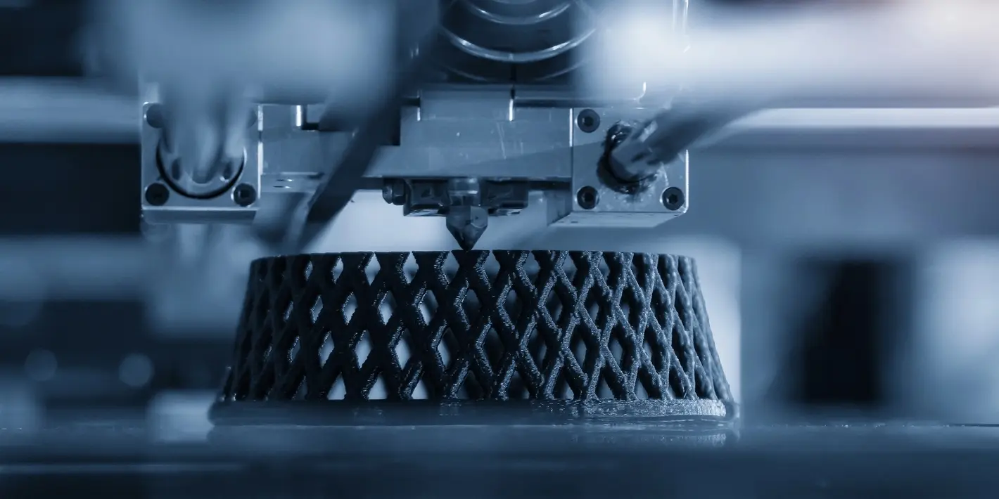

The dataset comprises 455 labeled images grouped into the categories: **Normal**, **Bubbles**, **Overextrusion**, **Overextrusion10**, and **Overextrusion40**. These images span the entire manufacturing process—from initial stages to the final part assembly—and are intended for use in computer vision applications. Each category name reflects a typical extrusion-related defect.

**Filename examples:**

* `Normal_1.png`: Final stage image from the “Normal” category
* `Normal_88.png`: Early-stage image of a normal process
* `Overextrusion_2.png`: Late-stage image showing overextrusion
* `Overextrusion40_80.png`: Early-stage image from the “Overextrusion40” set


---

Dataset: [3D printing process dataset](https://www.kaggle.com/datasets/marcelobatalhah/full-extruded-dataset/data)

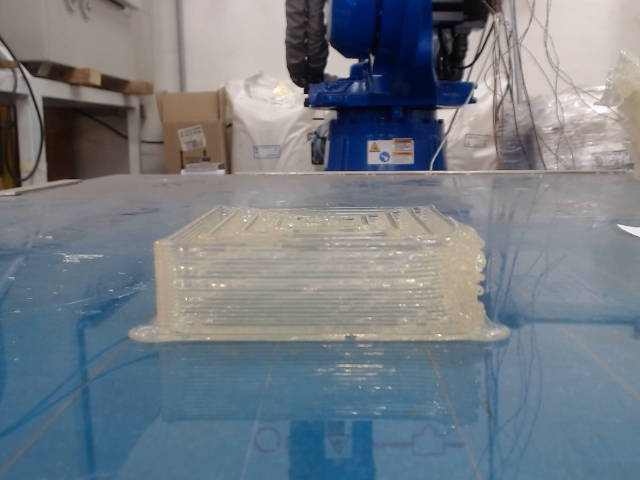

**Objective**:
This project aims to classify quality issues—such as overextrusion, overextrusion40, normal, and bubble defects—that arise during the additive manufacturing process, using Convolutional Neural Networks (CNNs).

# Data Preprocessing: Organizing 3D Printing Image Dataset into Classes and Splitting into Train and Test Sets


In [1]:
# Check GPU availability
!nvidia-smi

Tue Jun 10 23:46:44 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   42C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
data_path = '/content/drive/MyDrive/Addtive_Manufacturing_Dataset.zip'

In [3]:
from google.colab import drive
import zipfile
import os
import shutil
from sklearn.model_selection import train_test_split

# Mount Google Drive
drive.mount('/content/drive')

# Paths
zip_file_path = data_path  # Path on my Google Drive
extracted_dir = '/content/extracted_dataset/'
dataset_dir = '/content/organized_dataset/'

# Unzip the dataset
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extracted_dir)

# Check the extracted files
print(os.listdir(extracted_dir))

# Images should be in a single directroy, they'll be moved to class-based folders
class_names = ['Normal', 'bolhas', 'overextrusion', 'overextrusion10', 'overextrusion40']
for class_name in class_names:
    class_dir = os.path.join(extracted_dir, class_name)
    if not os.path.exists(class_dir):
        os.makedirs(class_dir)

# Organizing images into class directories
for filename in os.listdir(extracted_dir):
    if filename.endswith('.png'):
        class_name = filename.split('_')[0]
        src = os.path.join(extracted_dir, filename)
        dst = os.path.join(extracted_dir, class_name, filename)
        shutil.move(src, dst)

# Create the train and test directories
train_dir = os.path.join(dataset_dir, 'train')
test_dir = os.path.join(dataset_dir, 'test')

os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Split the data into train and test
for class_name in class_names:
    class_dir = os.path.join(extracted_dir, class_name)
    files = os.listdir(class_dir)
    train_files, test_files = train_test_split(files, test_size=0.1, random_state=42)

    # Create subdirectories for each class in the train and test directories
    os.makedirs(os.path.join(train_dir, class_name), exist_ok=True)
    os.makedirs(os.path.join(test_dir, class_name), exist_ok=True)

    # Move files to train and test directories
    for file in train_files:
        shutil.move(os.path.join(class_dir, file), os.path.join(train_dir, class_name, file))

    for file in test_files:
        shutil.move(os.path.join(class_dir, file), os.path.join(test_dir, class_name, file))

print("Dataset successfully organized into train and test directories!")

Mounted at /content/drive
['overextrusion40_86.png', 'overextrusion40_51.png', 'overextrusion10_62.png', 'bolhas_79.png', 'Normal_77.png', 'bolhas_27.png', 'Normal_65.png', 'overextrusion_13.png', 'overextrusion40_8.png', 'bolhas_18.png', 'overextrusion40_23.png', 'bolhas_43.png', 'overextrusion_91.png', 'overextrusion_87.png', 'Normal_47.png', 'bolhas_70.png', 'Normal_76.png', 'overextrusion_37.png', 'overextrusion10_3.png', 'overextrusion40_81.png', 'overextrusion40_71.png', 'overextrusion40_64.png', 'Normal_45.png', 'bolhas_47.png', 'overextrusion40_66.png', 'bolhas_29.png', 'overextrusion10_19.png', 'Normal_28.png', 'overextrusion40_62.png', 'overextrusion10_53.png', 'bolhas_62.png', 'overextrusion_10.png', 'overextrusion40_34.png', 'bolhas_63.png', 'overextrusion40_56.png', 'Normal_30.png', 'overextrusion40_15.png', 'overextrusion40_5.png', 'bolhas_57.png', 'overextrusion10_9.png', 'overextrusion40_25.png', 'overextrusion10_78.png', 'bolhas_35.png', 'bolhas_20.png', 'overextrusion

In [4]:
train_dir = '/content/organized_dataset/train'
test_dir = '/content/organized_dataset/test'

In [5]:
import os

# Function to get the number of images in each class folder
def count_images_in_folders(dataset_dir):
    class_counts = {}
    class_names = os.listdir(dataset_dir)

    for class_name in class_names:
        class_path = os.path.join(dataset_dir, class_name)
        if os.path.isdir(class_path):
            num_images = len(os.listdir(class_path))
            class_counts[class_name] = num_images
    return class_counts

# Check train data distribution
train_class_counts = count_images_in_folders(train_dir)
print("Train Set Distribution:", train_class_counts)

# Check test data distribution
test_class_counts = count_images_in_folders(test_dir)
print("Test Set Distribution:", test_class_counts)

# Check number of classes in each directory
num_train_classes = len(train_class_counts)
num_test_classes = len(test_class_counts)

print(f"Number of classes in train set: {num_train_classes}")
print(f"Number of classes in test set: {num_test_classes}")


Train Set Distribution: {'overextrusion40': 82, 'Normal': 81, 'overextrusion10': 81, 'bolhas': 81, 'overextrusion': 81}
Test Set Distribution: {'overextrusion40': 10, 'Normal': 10, 'overextrusion10': 9, 'bolhas': 10, 'overextrusion': 10}
Number of classes in train set: 5
Number of classes in test set: 5


#Exploratory Data Analysis: Random Image Samples from 3D Printing Dataset

In [6]:
import os
import random
import matplotlib.pyplot as plt
from matplotlib.image import imread

In [7]:
def  visualize_3Dprinting_images(train_dir, num_samples=5):

    class_names = os.listdir(train_dir)
    class_names = [d for d in class_names if os.path.isdir(os.path.join(train_dir, d))]
    sampled_images = []
    sampled_labels = []
    image_shapes = []

    for _ in range(num_samples):

        random_class = random.choice(class_names)
        class_dir = os.path.join(train_dir, random_class)
        image_files = os.listdir(class_dir)
        random_image = random.choice(image_files)
        sampled_images.append(os.path.join(class_dir, random_image))
        sampled_labels.append(random_class)
        img = imread(os.path.join(class_dir, random_image))
        image_shapes.append(img.shape)


    fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))

    for i, image_path in enumerate(sampled_images):
        img = imread(image_path)
        axes[i].imshow(img)
        axes[i].axis("off")
        axes[i].set_title(f"{sampled_labels[i]}\nShape: {image_shapes[i]}")

    plt.show()

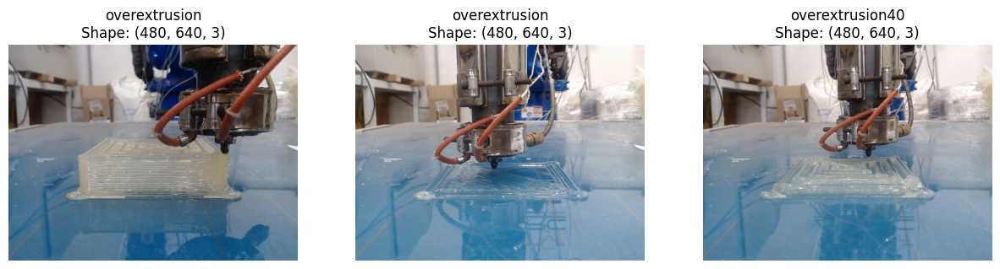

In [8]:
visualize_3Dprinting_images(train_dir, num_samples=3)

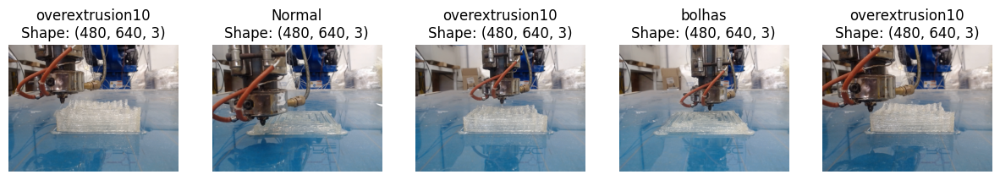

In [ ]:
visualize_3Dprinting_images(train_dir, num_samples=5)

In [9]:
# Get helper functions
url = 'https://raw.githubusercontent.com/emreCanIlik/PokeVision-Pok-mon-Classification-with-Deep-Learning/refs/heads/main/helper_functions.py'
!wget {url}

--2025-06-10 23:47:39--  https://raw.githubusercontent.com/emreCanIlik/PokeVision-Pok-mon-Classification-with-Deep-Learning/refs/heads/main/helper_functions.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10246 (10K) [text/plain]
Saving to: ‘helper_functions.py’

helper_functions.py 100%[===================>]  10.01K  --.-KB/s    in 0s      

2025-06-10 23:47:40 (92.0 MB/s) - ‘helper_functions.py’ saved [10246/10246]



In [38]:
from helper_functions import create_tensorboard_callback, plot_loss_curves

In [10]:
from helper_functions import *

#Creating TensorFlow Datasets for Training and Testing

In [11]:
import tensorflow as tf

In [12]:
IMG_SIZE = (400, 400)

In [13]:
BATCH_SIZE = 8

In [14]:
train_data = tf.keras.preprocessing.image_dataset_from_directory(train_dir,
                                                                image_size=IMG_SIZE,
                                                                label_mode="categorical",
                                                                batch_size=BATCH_SIZE)

test_data = tf.keras.preprocessing.image_dataset_from_directory(test_dir,
                                                               image_size=IMG_SIZE,
                                                               label_mode="categorical",
                                                               batch_size=BATCH_SIZE)

Found 406 files belonging to 5 classes.
Found 49 files belonging to 5 classes.


In [15]:
train_images, train_labels = next(iter(train_data))
test_images, test_labels = next(iter(test_data))

In [16]:
train_labels[:5]

<tf.Tensor: shape=(5, 5), dtype=float32, numpy=
array([[0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 0., 1., 0.]], dtype=float32)>

In [17]:
test_labels[:5]

<tf.Tensor: shape=(5, 5), dtype=float32, numpy=
array([[0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 1., 0., 0.]], dtype=float32)>

**Visualize random images from the iterative train dataset**

In [18]:
import matplotlib.pyplot as plt
import numpy as np
import random

def visualize_random_images_per_class(train_data, num_images_per_class=5):
    # Get class names from the train_data
    class_names = train_data.class_names

    # Create a figure for displaying images
    plt.figure(figsize=(15, 15))

    # Loop over each class
    for i, class_name in enumerate(class_names):
        # List to store images of the current class
        class_images = []

        # Loop over batches of images in train_data
        for image_batch, label_batch in train_data:
            # Loop through each image in the current batch
            for img, label in zip(image_batch, label_batch):
                if np.argmax(label) == i:
                    class_images.append(img)

        # Select 5 random images from the class (if there are enough images)
        num_images_to_display = min(len(class_images), num_images_per_class)
        random_images = random.sample(class_images, num_images_to_display)

        # Display images in a grid
        for j, img in enumerate(random_images):
            ax = plt.subplot(len(class_names), num_images_per_class, i * num_images_per_class + j + 1)
            plt.imshow(img.numpy().astype("uint8"))
            plt.title(class_name)
            plt.axis("off")

    plt.show()

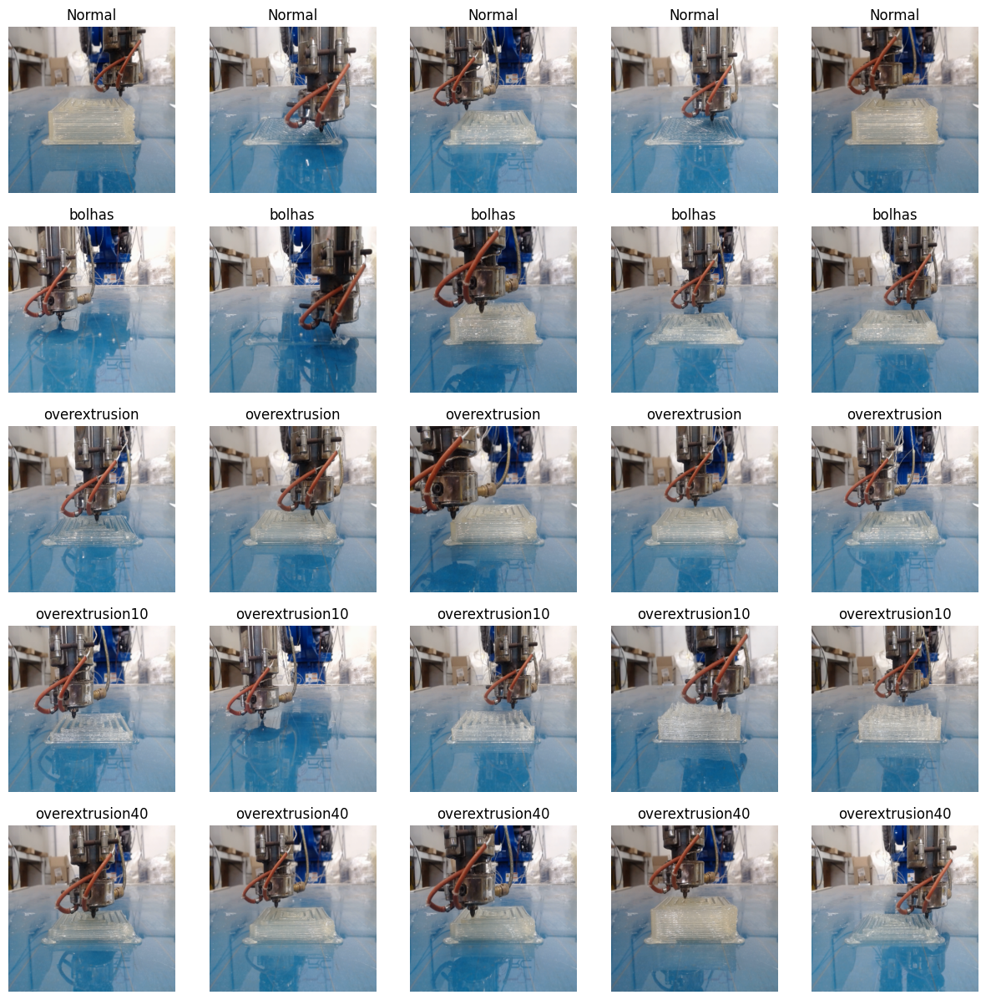

In [19]:
# Call the function to visualize random images from each class
visualize_random_images_per_class(train_data, num_images_per_class=5)

In [20]:
images, label = next(iter(train_data))

In [21]:
image_shape = images[0].shape
image_shape

TensorShape([400, 400, 3])

In [22]:
label

<tf.Tensor: shape=(8, 5), dtype=float32, numpy=
array([[0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1.],
       [0., 0., 1., 0., 0.]], dtype=float32)>

In [23]:
class_names = train_data.class_names
num_classes = len(class_names)
print(f"The class names are {class_names}.\nThere are {num_classes} classes on total")

The class names are ['Normal', 'bolhas', 'overextrusion', 'overextrusion10', 'overextrusion40'].
There are 5 classes on total


# Simple CNN Approach

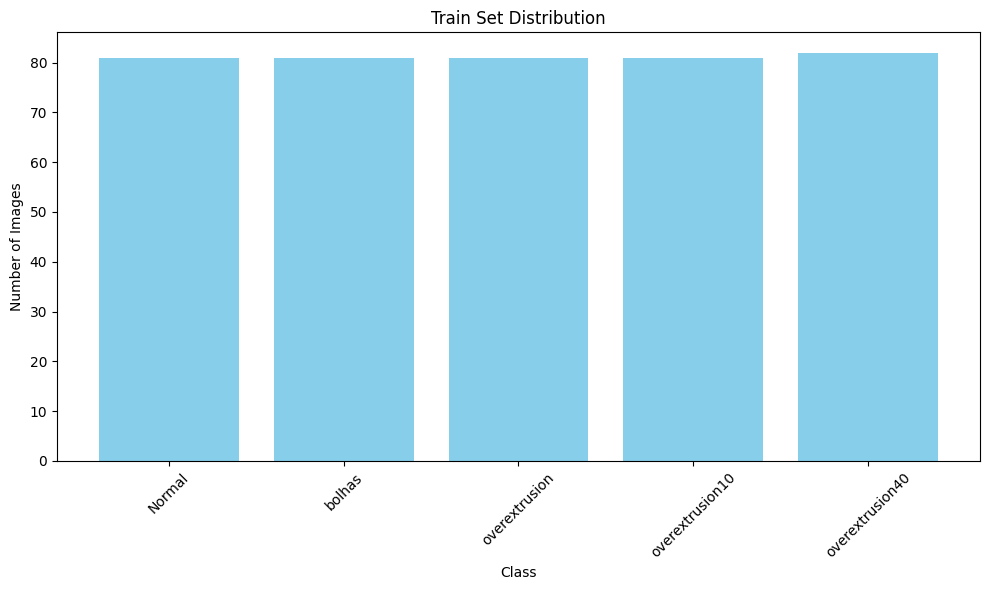

In [24]:
# Check Class Imbalance

import numpy as np
import matplotlib.pyplot as plt

# Compute the distribution over the entire dataset
class_counts = {class_name: 0 for class_name in train_data.class_names}

for images, labels in train_data:
    label_indices = np.argmax(labels, axis=1)
    for idx in label_indices:
        class_name = train_data.class_names[idx]
        class_counts[class_name] += 1


classes = list(class_counts.keys())
counts = list(class_counts.values())

# Plot the bar chart
plt.figure(figsize=(10, 6))
plt.bar(classes, counts, color='skyblue')
plt.xlabel('Class')
plt.ylabel('Number of Images')
plt.title('Train Set Distribution')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [25]:
# Create a folder for Tensorboard Logs
import os
os.makedirs('model_logs', exist_ok=True)

In [26]:
SAVE_DIR = '/content/model_logs'

In [27]:
import tensorflow as tf
from tensorflow.keras import layers, Input
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.regularizers import l2

In [28]:
def get_simple_cnn(input_shape):

  """
  This function creates a simple CNN model with the following architecture:
  Input Layer -> ConvBlock1 -> ConvBlock2 -> ConvBlock3 -> ConvBlock4 -> Flatten -> Classifier
  arguments: input_shape ( shape of the images)
  returns: a simple CNN model
  """

  # Input layer
  inputs = Input(shape=(input_shape))
  # Rescaling layer to normalize the images
  x = layers.Rescaling(1./255)(inputs)
  # Block 1
  x = layers.Conv2D(128, 3, kernel_regularizer=l2(0.001) ,activation='relu')(x)
  x = layers.MaxPool2D(2, 2)(x)

  # Block 2
  x = layers.Conv2D(128, 3, kernel_regularizer=l2(0.001), activation='relu')(x)
  x = layers.MaxPool2D(2, 2)(x)
  x = layers.BatchNormalization()(x)

  # Block 3
  x = layers.Conv2D(128, 3, kernel_regularizer=l2(0.001), activation='relu')(x)
  x = layers.MaxPool2D(2, 2)(x)
  x = layers.BatchNormalization()(x)

  # Block 4
  x = layers.Conv2D(128, 3, kernel_regularizer=l2(0.001), activation='relu')(x)
  x = layers.MaxPool2D(2, 2)(x)
  x = layers.BatchNormalization()(x)

  # Flatten layer to craft a feature vector
  x = layers.GlobalMaxPool2D()(x)

  # Classifier block
  x = layers.Dense(128, activation='relu')(x)
  x = layers.Dropout(0.4)(x)
  outputs = layers.Dense(num_classes, activation='softmax')(x)

  # Build model
  model = Model(inputs, outputs)

  # Compile the model
  model.compile(loss='categorical_crossentropy',
                optimizer=tf.keras.optimizers.Adam(),
                metrics=['accuracy'])

  return model


In [29]:
simple_cnn = get_simple_cnn(image_shape)

In [30]:
simple_cnn.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 400, 400, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling (Rescaling)           │ (None, 400, 400, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 398, 398, 128)  │         3,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 199, 199, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 197, 197, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 98, 98, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 98, 98, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 96, 96, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 48, 48, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 48, 48, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 46, 46, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 23, 23, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 23, 23, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling2d            │ (None, 128)            │             0 │
│ (GlobalMaxPooling2D)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 5)              │           645 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 465,029 (1.77 MB)

 Trainable params: 464,261 (1.77 MB)

 Non-trainable params: 768 (3.00 KB)

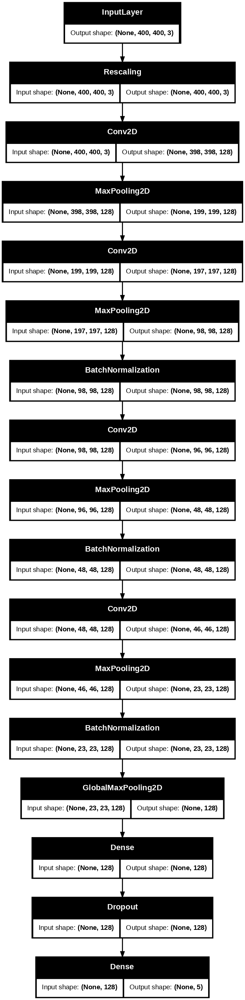

In [36]:
from tensorflow.keras.utils import plot_model
plot_model(simple_cnn, show_shapes=True, dpi=100)

In [39]:
history_simple = simple_cnn.fit(train_data,
                                epochs=30,
                                validation_data=test_data,
                                callbacks=[create_tensorboard_callback(SAVE_DIR,
                                                                       experiment_name='simple_cnn')])

Saving TensorBoard log files to: /content/model_logs/simple_cnn/20250610-235340
Epoch 1/30
51/51 ━━━━━━━━━━━━━━━━━━━━ 46s 564ms/step - accuracy: 0.1941 - loss: 3.3518 - val_accuracy: 0.2041 - val_loss: 2.1383
Epoch 2/30
51/51 ━━━━━━━━━━━━━━━━━━━━ 6s 119ms/step - accuracy: 0.2294 - loss: 2.0030 - val_accuracy: 0.1837 - val_loss: 2.0783
Epoch 3/30
51/51 ━━━━━━━━━━━━━━━━━━━━ 6s 119ms/step - accuracy: 0.2075 - loss: 1.9782 - val_accuracy: 0.2449 - val_loss: 1.9804
Epoch 4/30
51/51 ━━━━━━━━━━━━━━━━━━━━ 10s 113ms/step - accuracy: 0.1793 - loss: 1.9488 - val_accuracy: 0.2041 - val_loss: 1.9664
Epoch 5/30
51/51 ━━━━━━━━━━━━━━━━━━━━ 10s 114ms/step - accuracy: 0.2123 - loss: 1.9459 - val_accuracy: 0.1020 - val_loss: 1.9483
Epoch 6/30
51/51 ━━━━━━━━━━━━━━━━━━━━ 10s 118ms/step - accuracy: 0.1772 - loss: 1.9382 - val_accuracy: 0.2041 - val_loss: 1.9244
Epoch 7/30
51/51 ━━━━━━━━━━━━━━━━━━━━ 6s 120ms/step - accuracy: 0.1884 - loss: 1.9175 - val_accuracy: 0.1837 - val_loss: 1.9147
Epoch 8/30
51/51 ━━━

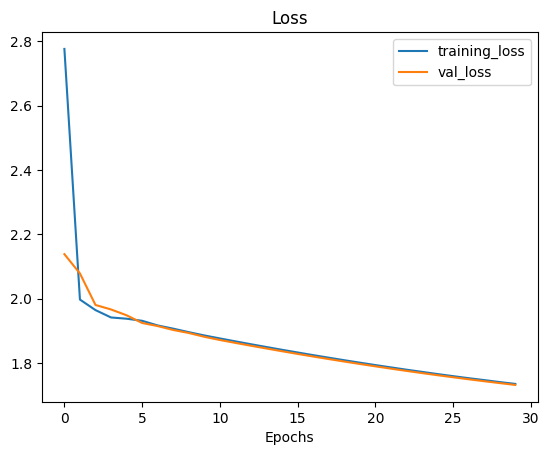

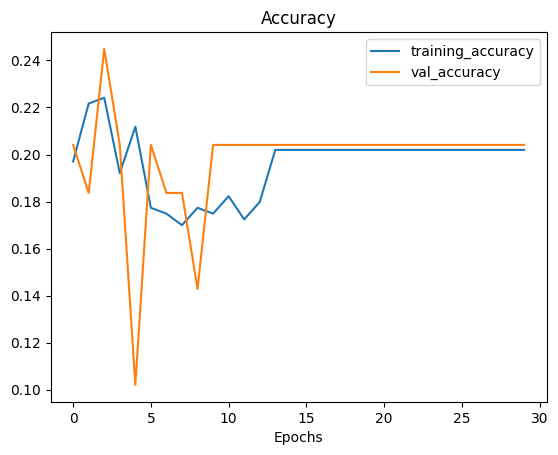

In [40]:
plot_loss_curves(history_simple)

In [41]:
loss_simplecnn, accuracy_simplecnn, = simple_cnn.evaluate(test_data)
loss_simplecnn, accuracy_simplecnn

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - accuracy: 0.2510 - loss: 1.7312


(1.7317768335342407, 0.20408163964748383)

# Transfer Learning with EffcientNetV2B0

In [42]:
def get_effnet_model(input_shape):
  """
  This functions creates an EfficientNetV2B0 model
  arguments: input_shape (shape of the images)
  returns: an EfficientNetV2B0 model
  """
  # Import EffcientNetV2B0
  effnet = tf.keras.applications.efficientnet_v2.EfficientNetV2B0(include_top=False)
  # Freeze layers of the EffcientNetV2B0
  effnet.trainable = False

  # Create the input layer
  images = layers.Input(shape=input_shape, name="input_layer")
  # Incorporate the EffNetV2B0
  x = effnet(images, training=False)
  # Include Pooling layer to create a feature vector
  x = layers.GlobalAveragePooling2D(name="global_average_pooling_layer")(x)

  # Classifier
  x = layers.Dense(128, activation="relu", name='fully_connected_dense_layer_1')(x)
  x = layers.Dropout(0.4)(x)
  outputs = layers.Dense(num_classes, activation="softmax", name="output_layer")(x)

  # Build the model
  model = tf.keras.Model(images, outputs)

  # Compile the model
  model.compile(loss="categorical_crossentropy",
                optimizer=tf.keras.optimizers.Adam(),
                metrics=["accuracy"])

  return model

In [43]:
model_effnet = get_effnet_model(image_shape)

24274472/24274472 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [44]:
model_effnet.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 400, 400, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetv2-b0 (Functional)  │ (None, 13, 13, 1280)   │     5,919,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling_layer    │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fully_connected_dense_layer_1   │ (None, 128)            │       163,968 │
│ (Dense)                         │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output_layer (Dense)            │ (None, 5)              │           645 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,083,925 (23.21 MB)

 Trainable params: 164,613 (643.02 KB)

 Non-trainable params: 5,919,312 (22.58 MB)

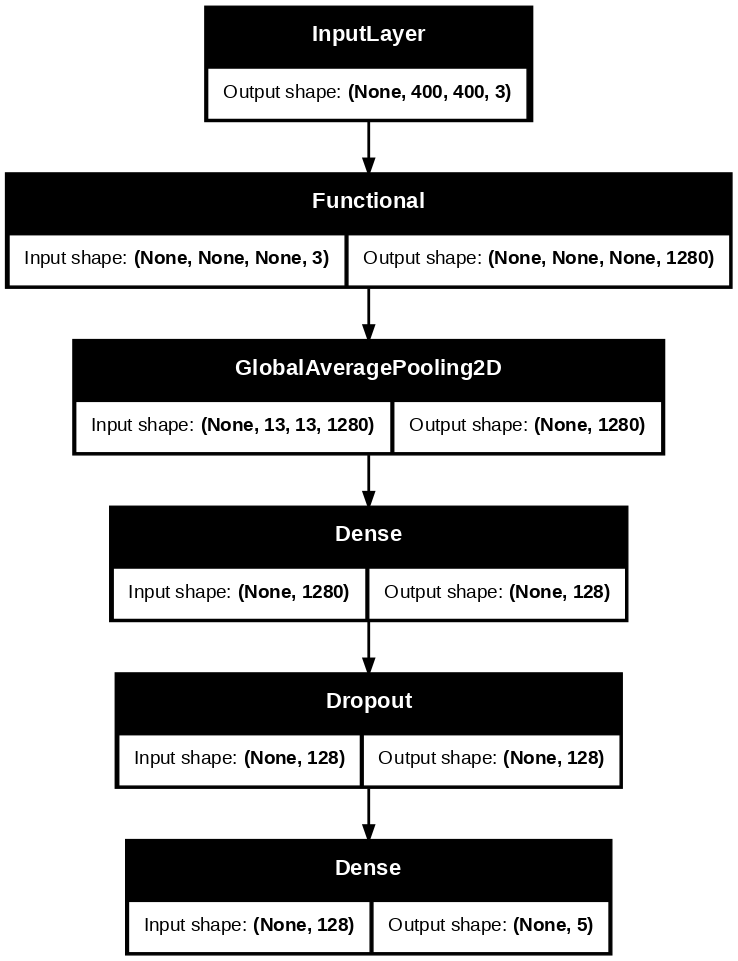

In [45]:
plot_model(model_effnet, show_shapes=True, dpi=100)

In [46]:
# Display the layers of EffNetB2V0
effnet = model_effnet.layers[1]
effnet.summary()

Model: "efficientnetv2-b0"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_1         │ (None, None,      │          0 │ input_layer_1[0]… │
│ (Rescaling)         │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization       │ (None, None,      │          0 │ rescaling_1[0][0] │
│ (Normalization)     │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, None,      │        864 │ normalization[0]… │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, None,      │        128 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, None,      │          0 │ stem_bn[0][0]     │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, None,      │      4,608 │ stem_activation[… │
│ (Conv2D)            │ None, 16)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_bn  │ (None, None,      │         64 │ block1a_project_… │
│ (BatchNormalizatio… │ None, 16)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_ac… │ (None, None,      │          0 │ block1a_project_… │
│ (Activation)        │ None, 16)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_expand_conv │ (None, None,      │      9,216 │ block1a_project_… │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_expand_bn   │ (None, None,      │        256 │ block2a_expand_c… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_expand_act… │ (None, None,      │          0 │ block2a_expand_b… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_project_co… │ (None, None,      │      2,048 │ block2a_expand_a… │
│ (Conv2D)            │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_project_bn  │ (None, None,      │        128 │ block2a_project_… │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2b_expand_conv │ (None, None,      │     36,864 │ block2a_project_… │
│ (Conv2D)            │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2b_expand_bn   │ (None, None,      │        512 │ block2b_expand_c… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2b_expand_act… │ (None, None,      │          0 │ block2b_expand_b

 Total params: 5,919,312 (22.58 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 5,919,312 (22.58 MB)

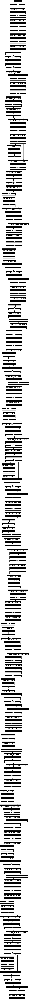

In [47]:
plot_model(effnet, show_shapes=True, dpi=100)

In [48]:
pretraining_epochs = 15
history_effnet = model_effnet.fit(train_data,
                                  epochs=pretraining_epochs,
                                  validation_data=test_data,
                                  callbacks=[create_tensorboard_callback(dir_name=SAVE_DIR,
                                                                         experiment_name='effnet_model')])

Saving TensorBoard log files to: /content/model_logs/effnet_model/20250611-000135
Epoch 1/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 57s 595ms/step - accuracy: 0.1935 - loss: 1.7799 - val_accuracy: 0.4490 - val_loss: 1.4264
Epoch 2/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 41s 61ms/step - accuracy: 0.3234 - loss: 1.4544 - val_accuracy: 0.6122 - val_loss: 1.2609
Epoch 3/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 63ms/step - accuracy: 0.5312 - loss: 1.2496 - val_accuracy: 0.6735 - val_loss: 1.1026
Epoch 4/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 66ms/step - accuracy: 0.5531 - loss: 1.1241 - val_accuracy: 0.5918 - val_loss: 1.0547
Epoch 5/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 61ms/step - accuracy: 0.6373 - loss: 1.0215 - val_accuracy: 0.8367 - val_loss: 0.9081
Epoch 6/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 7s 92ms/step - accuracy: 0.6684 - loss: 0.9160 - val_accuracy: 0.8367 - val_loss: 0.8023
Epoch 7/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 67ms/step - accuracy: 0.7786 - loss: 0.7538 - val_accuracy: 0.7959 - val_loss: 0.7526
Epoch 8/15
51/51 ━━━━━━━━━

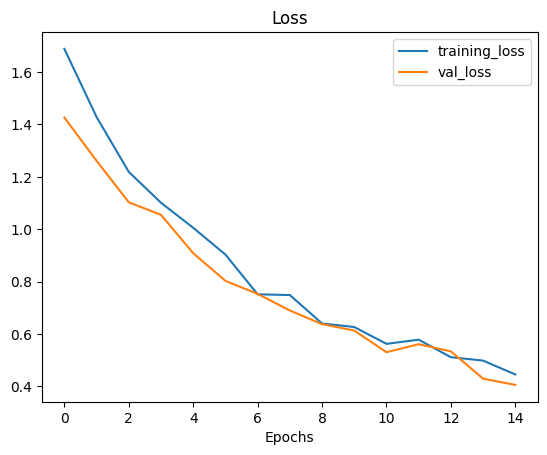

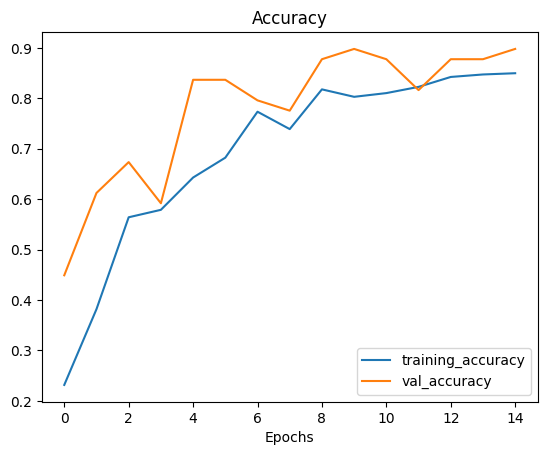

In [49]:
plot_loss_curves(history_effnet)

In [50]:
loss_effnet, accuracy_effnet = model_effnet.evaluate(test_data)
loss_effnet, accuracy_effnet

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - accuracy: 0.9359 - loss: 0.3733


(0.40492182970046997, 0.8979591727256775)

# Fine-Tuning EfficientNetV2B0

In [51]:
model_effnet.layers

[<InputLayer name=input_layer, built=True>,
 <Functional name=efficientnetv2-b0, built=True>,
 <GlobalAveragePooling2D name=global_average_pooling_layer, built=True>,
 <Dense name=fully_connected_dense_layer_1, built=True>,
 <Dropout name=dropout_1, built=True>,
 <Dense name=output_layer, built=True>]

In [52]:
for layer_number, layer in enumerate(model_effnet.layers):
  print(f"Layer number {layer_number} | Layer name: {layer.name} | trainable status: {layer.trainable}")

Layer number 0 | Layer name: input_layer | trainable status: True
Layer number 1 | Layer name: efficientnetv2-b0 | trainable status: False
Layer number 2 | Layer name: global_average_pooling_layer | trainable status: True
Layer number 3 | Layer name: fully_connected_dense_layer_1 | trainable status: True
Layer number 4 | Layer name: dropout_1 | trainable status: True
Layer number 5 | Layer name: output_layer | trainable status: True


In [53]:
model_effnet.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 400, 400, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetv2-b0 (Functional)  │ (None, 13, 13, 1280)   │     5,919,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling_layer    │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fully_connected_dense_layer_1   │ (None, 128)            │       163,968 │
│ (Dense)                         │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output_layer (Dense)            │ (None, 5)              │           645 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,413,153 (24.46 MB)

 Trainable params: 164,613 (643.02 KB)

 Non-trainable params: 5,919,312 (22.58 MB)

 Optimizer params: 329,228 (1.26 MB)

In [54]:
for i, layer in enumerate(model_effnet.layers[1].layers):
  print(i, layer.name, layer.trainable)

0 input_layer_1 False
1 rescaling_1 False
2 normalization False
3 stem_conv False
4 stem_bn False
5 stem_activation False
6 block1a_project_conv False
7 block1a_project_bn False
8 block1a_project_activation False
9 block2a_expand_conv False
10 block2a_expand_bn False
11 block2a_expand_activation False
12 block2a_project_conv False
13 block2a_project_bn False
14 block2b_expand_conv False
15 block2b_expand_bn False
16 block2b_expand_activation False
17 block2b_project_conv False
18 block2b_project_bn False
19 block2b_drop False
20 block2b_add False
21 block3a_expand_conv False
22 block3a_expand_bn False
23 block3a_expand_activation False
24 block3a_project_conv False
25 block3a_project_bn False
26 block3b_expand_conv False
27 block3b_expand_bn False
28 block3b_expand_activation False
29 block3b_project_conv False
30 block3b_project_bn False
31 block3b_drop False
32 block3b_add False
33 block4a_expand_conv False
34 block4a_expand_bn False
35 block4a_expand_activation False
36 block4a_dwco

In [55]:
print(len(model_effnet.trainable_variables))

4


In [56]:
print(len(model_effnet.layers[1].trainable_variables))

0


In [57]:
model_effnet_fine_tuning = model_effnet.layers[1]
model_effnet_fine_tuning.name

'efficientnetv2-b0'

In [58]:
print(len(model_effnet_fine_tuning.trainable_variables))

0


In [59]:
for layer_number, layer_name in enumerate(model_effnet_fine_tuning.layers):
  print(layer_number, layer_name, layer_name.trainable)

0 <InputLayer name=input_layer_1, built=True> False
1 <Rescaling name=rescaling_1, built=True> False
2 <Normalization name=normalization, built=True> False
3 <Conv2D name=stem_conv, built=True> False
4 <BatchNormalization name=stem_bn, built=True> False
5 <Activation name=stem_activation, built=True> False
6 <Conv2D name=block1a_project_conv, built=True> False
7 <BatchNormalization name=block1a_project_bn, built=True> False
8 <Activation name=block1a_project_activation, built=True> False
9 <Conv2D name=block2a_expand_conv, built=True> False
10 <BatchNormalization name=block2a_expand_bn, built=True> False
11 <Activation name=block2a_expand_activation, built=True> False
12 <Conv2D name=block2a_project_conv, built=True> False
13 <BatchNormalization name=block2a_project_bn, built=True> False
14 <Conv2D name=block2b_expand_conv, built=True> False
15 <BatchNormalization name=block2b_expand_bn, built=True> False
16 <Activation name=block2b_expand_activation, built=True> False
17 <Conv2D name=

In [60]:
# Make all the layers in model_effnet_fine_tuning trainable
model_effnet_fine_tuning.trainable = True

# Freeze all the layers except for the last 15
for layer in model_effnet_fine_tuning.layers[:-15]:
  layer.trainable = False

In [61]:
model_effnet_fine_tuning.compile(loss="categorical_crossentropy",
                                 optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
                                 metrics=["accuracy"])

In [62]:
for layer_number, layer in enumerate(model_effnet_fine_tuning.layers):
  print(f"Layer number {layer_number} | Layer name: {layer.name} | trainable status: {layer.trainable}")

Layer number 0 | Layer name: input_layer_1 | trainable status: False
Layer number 1 | Layer name: rescaling_1 | trainable status: False
Layer number 2 | Layer name: normalization | trainable status: False
Layer number 3 | Layer name: stem_conv | trainable status: False
Layer number 4 | Layer name: stem_bn | trainable status: False
Layer number 5 | Layer name: stem_activation | trainable status: False
Layer number 6 | Layer name: block1a_project_conv | trainable status: False
Layer number 7 | Layer name: block1a_project_bn | trainable status: False
Layer number 8 | Layer name: block1a_project_activation | trainable status: False
Layer number 9 | Layer name: block2a_expand_conv | trainable status: False
Layer number 10 | Layer name: block2a_expand_bn | trainable status: False
Layer number 11 | Layer name: block2a_expand_activation | trainable status: False
Layer number 12 | Layer name: block2a_project_conv | trainable status: False
Layer number 13 | Layer name: block2a_project_bn | train

In [63]:
print(len(model_effnet_fine_tuning.trainable_variables))

13


In [64]:
print(len(model_effnet.trainable_variables))

17


In [65]:
fine_tuning_epochs = pretraining_epochs + 8

In [66]:
history_fine_tuning_effnet = model_effnet.fit(train_data,
                                              epochs=fine_tuning_epochs,
                                              initial_epoch=history_effnet.epoch[-1],
                                              validation_data=test_data,
                                              callbacks=[create_tensorboard_callback(dir_name=SAVE_DIR,
                                                                                     experiment_name='effnet_fine-tuning')])

Saving TensorBoard log files to: /content/model_logs/effnet_fine-tuning/20250611-000503
Epoch 15/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 3s 62ms/step - accuracy: 0.8833 - loss: 0.3933 - val_accuracy: 0.8980 - val_loss: 0.3834
Epoch 16/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 3s 68ms/step - accuracy: 0.8568 - loss: 0.4271 - val_accuracy: 0.8980 - val_loss: 0.4049
Epoch 17/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 74ms/step - accuracy: 0.9038 - loss: 0.3361 - val_accuracy: 0.8776 - val_loss: 0.3695
Epoch 18/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 68ms/step - accuracy: 0.8530 - loss: 0.4328 - val_accuracy: 0.8980 - val_loss: 0.3400
Epoch 19/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 73ms/step - accuracy: 0.9007 - loss: 0.3187 - val_accuracy: 0.8776 - val_loss: 0.3542
Epoch 20/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step - accuracy: 0.9336 - loss: 0.2902 - val_accuracy: 0.8980 - val_loss: 0.3765
Epoch 21/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 3s 66ms/step - accuracy: 0.9095 - loss: 0.3215 - val_accuracy: 0.8776 - val_loss: 0.3793
Epoch 22/23
51/5

In [67]:
fine_tune_effnet_loss, fine_tune_effnet_accuracy = model_effnet.evaluate(test_data)
fine_tune_effnet_loss, fine_tune_effnet_accuracy

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step - accuracy: 0.8578 - loss: 0.4327


(0.332719087600708, 0.8979591727256775)

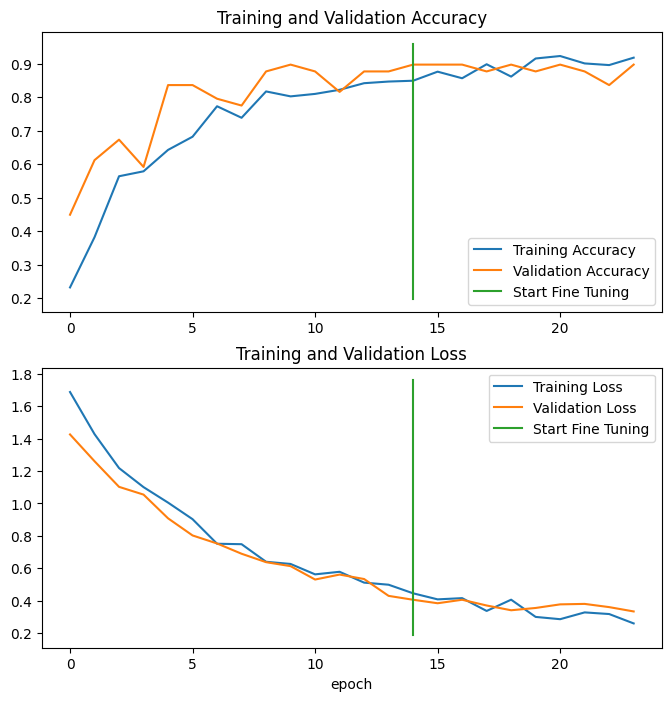

In [68]:
compare_historys(original_history=history_effnet,
                 new_history=history_fine_tuning_effnet,
                 initial_epochs=pretraining_epochs)

# Transfer Learning with ResNet50

In [69]:
def get_resnet_model(input_shape):

  """
  This function creates a ResNet50 model
  arguments: input_shape (shape of the images)
  returns: a ResNet50 model
  """

  # Import ResNet50
  resnet_model = tf.keras.applications.resnet50.ResNet50(include_top=False)
  # Freeze the model layers of ResNet50
  resnet_model.trainable = False

  # Define the input layer
  inputs = layers.Input(shape=input_shape, name="input_layer_resnet")


  # Pass the augmented images through the pre-trained ResNet50 model
  x = resnet_model(inputs, training=False)

  # Apply Global Average Pooling
  x = layers.GlobalAveragePooling2D(name="global_average_pooling_layer")(x)

  # Classifier
  x = layers.Dense(1024, activation="relu")(x)
  x = layers.Dropout(0.5)(x)
  outputs = layers.Dense(num_classes, activation="softmax", name="output_layer")(x)

  # Build the model
  model = tf.keras.Model(inputs, outputs)

  # Compile the model
  model.compile(loss="categorical_crossentropy",
                optimizer=tf.keras.optimizers.Adam(),
                metrics=["accuracy"])

  return model


In [70]:
# Create the model
model_resnet50 = get_resnet_model(image_shape)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [71]:
model_resnet50.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_resnet (InputLayer) │ (None, 400, 400, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ resnet50 (Functional)           │ (None, 13, 13, 2048)   │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling_layer    │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1024)           │     2,098,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output_layer (Dense)            │ (None, 5)              │         5,125 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 25,691,013 (98.00 MB)

 Trainable params: 2,103,301 (8.02 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

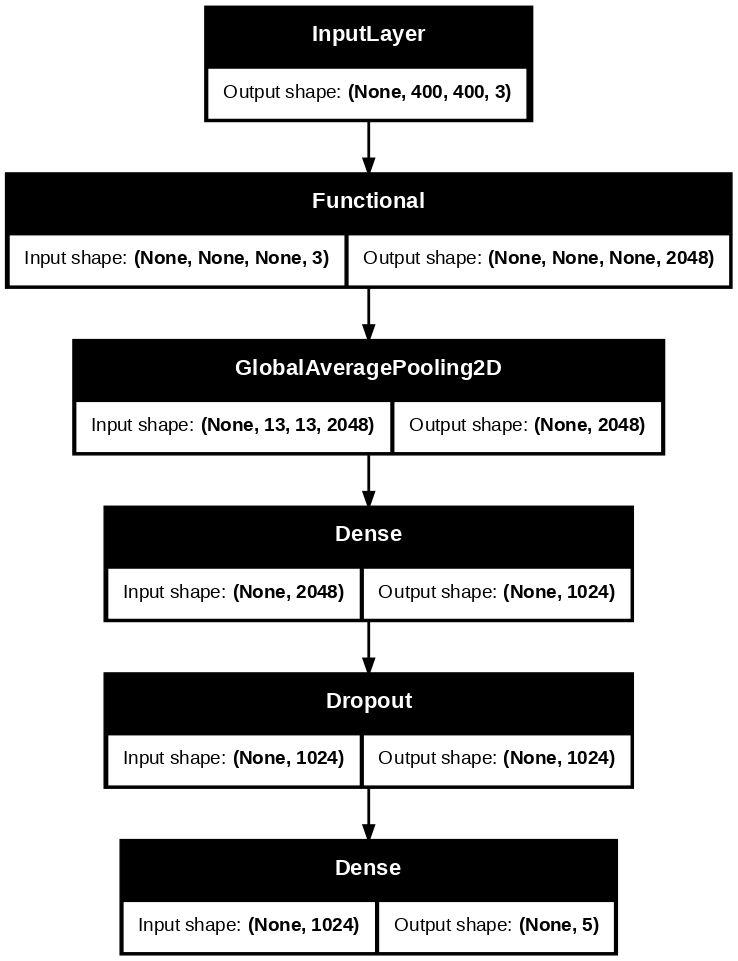

In [72]:
plot_model(model_resnet50, show_shapes=True, dpi=100)

In [74]:
# Get resnet_model
resnet_model = model_resnet50.layers[1]
resnet_model.summary()

Model: "resnet50"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, None,      │          0 │ input_layer_2[0]… │
│ (ZeroPadding2D)     │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, None,      │      9,472 │ conv1_pad[0][0]   │
│                     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, None,      │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, None,      │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, None,      │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, None,      │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, None,      │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, None,      │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, None,      │          0 │ conv2_block1_1_b… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, None,      │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, None,      │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, None,      │          0 │ conv2_block1_2_b… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, None,      │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ None, 256)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, None,      │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ None, 256)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, None,      │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ None, 256)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, None,      │      1,024 │ conv2_block1_3_c

 Total params: 23,587,712 (89.98 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 23,587,712 (89.98 MB)

In [75]:
plot_model(resnet_model, show_shapes=True, dpi=100)

In [76]:
history_resnet = model_resnet50.fit(train_data,
                                    epochs=15,
                                    validation_data=test_data,
                                    callbacks=[create_tensorboard_callback(dir_name=SAVE_DIR,
                                                                           experiment_name='model_resnet50')])

Saving TensorBoard log files to: /content/model_logs/model_resnet50/20250611-000738
Epoch 1/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 30s 332ms/step - accuracy: 0.1887 - loss: 3.0225 - val_accuracy: 0.3673 - val_loss: 1.4296
Epoch 2/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.3333 - loss: 1.6075 - val_accuracy: 0.7143 - val_loss: 1.1387
Epoch 3/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 80ms/step - accuracy: 0.4507 - loss: 1.2780 - val_accuracy: 0.5714 - val_loss: 1.0199
Epoch 4/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 6s 102ms/step - accuracy: 0.6235 - loss: 1.0046 - val_accuracy: 0.7755 - val_loss: 0.8626
Epoch 5/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 81ms/step - accuracy: 0.6983 - loss: 0.9000 - val_accuracy: 0.7959 - val_loss: 0.7699
Epoch 6/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 82ms/step - accuracy: 0.7733 - loss: 0.6871 - val_accuracy: 0.7551 - val_loss: 0.7162
Epoch 7/15
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 99ms/step - accuracy: 0.7116 - loss: 0.7329 - val_accuracy: 0.6735 - val_loss: 0.7085
Epoch 8/15
51/51 ━━━━━━━

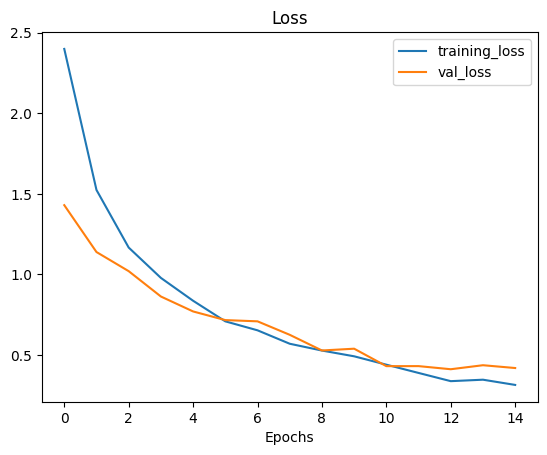

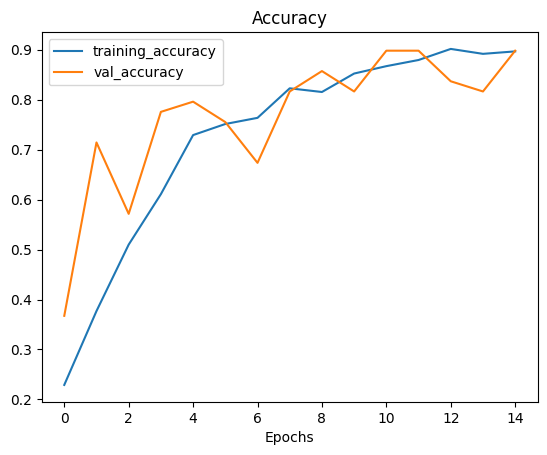

In [77]:
plot_loss_curves(history_resnet)

In [78]:
loss_resnet50, accuracy_resnet50 = model_resnet50.evaluate(test_data)
loss_resnet50, accuracy_resnet50

7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step - accuracy: 0.8708 - loss: 0.4908


(0.41869810223579407, 0.8979591727256775)

# Fine-Tuning ResNet50

In [79]:
model_resnet50.layers

[<InputLayer name=input_layer_resnet, built=True>,
 <Functional name=resnet50, built=True>,
 <GlobalAveragePooling2D name=global_average_pooling_layer, built=True>,
 <Dense name=dense_2, built=True>,
 <Dropout name=dropout_2, built=True>,
 <Dense name=output_layer, built=True>]

In [80]:
for layer_number, layer in enumerate(model_resnet50.layers):
  print(f"Layer number {layer_number} | Layer name: {layer.name} | trainable status: {layer.trainable}")

Layer number 0 | Layer name: input_layer_resnet | trainable status: True
Layer number 1 | Layer name: resnet50 | trainable status: False
Layer number 2 | Layer name: global_average_pooling_layer | trainable status: True
Layer number 3 | Layer name: dense_2 | trainable status: True
Layer number 4 | Layer name: dropout_2 | trainable status: True
Layer number 5 | Layer name: output_layer | trainable status: True


In [81]:
model_resnet50.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_resnet (InputLayer) │ (None, 400, 400, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ resnet50 (Functional)           │ (None, 13, 13, 2048)   │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling_layer    │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1024)           │     2,098,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output_layer (Dense)            │ (None, 5)              │         5,125 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 29,897,617 (114.05 MB)

 Trainable params: 2,103,301 (8.02 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

 Optimizer params: 4,206,604 (16.05 MB)

In [82]:
for i, layer in enumerate(model_resnet50.layers[1].layers):
  print(i, layer.name, layer.trainable)

0 input_layer_2 False
1 conv1_pad False
2 conv1_conv False
3 conv1_bn False
4 conv1_relu False
5 pool1_pad False
6 pool1_pool False
7 conv2_block1_1_conv False
8 conv2_block1_1_bn False
9 conv2_block1_1_relu False
10 conv2_block1_2_conv False
11 conv2_block1_2_bn False
12 conv2_block1_2_relu False
13 conv2_block1_0_conv False
14 conv2_block1_3_conv False
15 conv2_block1_0_bn False
16 conv2_block1_3_bn False
17 conv2_block1_add False
18 conv2_block1_out False
19 conv2_block2_1_conv False
20 conv2_block2_1_bn False
21 conv2_block2_1_relu False
22 conv2_block2_2_conv False
23 conv2_block2_2_bn False
24 conv2_block2_2_relu False
25 conv2_block2_3_conv False
26 conv2_block2_3_bn False
27 conv2_block2_add False
28 conv2_block2_out False
29 conv2_block3_1_conv False
30 conv2_block3_1_bn False
31 conv2_block3_1_relu False
32 conv2_block3_2_conv False
33 conv2_block3_2_bn False
34 conv2_block3_2_relu False
35 conv2_block3_3_conv False
36 conv2_block3_3_bn False
37 conv2_block3_add False
38 conv

In [83]:
print(len(model_resnet50.trainable_variables))

4


In [84]:
print(len(model_resnet50.layers[1].trainable_variables))

0


In [85]:
model_resnet_fine_tuning = model_resnet50.layers[1]
model_resnet_fine_tuning.name

'resnet50'

In [86]:
print(len(model_resnet_fine_tuning.trainable_variables))

0


In [87]:
for layer_number, layer_name in enumerate(model_resnet_fine_tuning.layers):
  print(layer_number, layer_name, layer_name.trainable)

0 <InputLayer name=input_layer_2, built=True> False
1 <ZeroPadding2D name=conv1_pad, built=True> False
2 <Conv2D name=conv1_conv, built=True> False
3 <BatchNormalization name=conv1_bn, built=True> False
4 <Activation name=conv1_relu, built=True> False
5 <ZeroPadding2D name=pool1_pad, built=True> False
6 <MaxPooling2D name=pool1_pool, built=True> False
7 <Conv2D name=conv2_block1_1_conv, built=True> False
8 <BatchNormalization name=conv2_block1_1_bn, built=True> False
9 <Activation name=conv2_block1_1_relu, built=True> False
10 <Conv2D name=conv2_block1_2_conv, built=True> False
11 <BatchNormalization name=conv2_block1_2_bn, built=True> False
12 <Activation name=conv2_block1_2_relu, built=True> False
13 <Conv2D name=conv2_block1_0_conv, built=True> False
14 <Conv2D name=conv2_block1_3_conv, built=True> False
15 <BatchNormalization name=conv2_block1_0_bn, built=True> False
16 <BatchNormalization name=conv2_block1_3_bn, built=True> False
17 <Add name=conv2_block1_add, built=True> False
18

In [88]:
# Make all the layers in model_resnet_fine_tuning trainable
model_resnet_fine_tuning.trainable = True

# Freeze all the layers except for the last 15
for layer in model_resnet_fine_tuning.layers[:-15]:
  layer.trainable = False

In [89]:
for layer_number, layer_name in enumerate(model_resnet_fine_tuning.layers):
  print(layer_number, layer_name, layer_name.trainable)

0 <InputLayer name=input_layer_2, built=True> False
1 <ZeroPadding2D name=conv1_pad, built=True> False
2 <Conv2D name=conv1_conv, built=True> False
3 <BatchNormalization name=conv1_bn, built=True> False
4 <Activation name=conv1_relu, built=True> False
5 <ZeroPadding2D name=pool1_pad, built=True> False
6 <MaxPooling2D name=pool1_pool, built=True> False
7 <Conv2D name=conv2_block1_1_conv, built=True> False
8 <BatchNormalization name=conv2_block1_1_bn, built=True> False
9 <Activation name=conv2_block1_1_relu, built=True> False
10 <Conv2D name=conv2_block1_2_conv, built=True> False
11 <BatchNormalization name=conv2_block1_2_bn, built=True> False
12 <Activation name=conv2_block1_2_relu, built=True> False
13 <Conv2D name=conv2_block1_0_conv, built=True> False
14 <Conv2D name=conv2_block1_3_conv, built=True> False
15 <BatchNormalization name=conv2_block1_0_bn, built=True> False
16 <BatchNormalization name=conv2_block1_3_bn, built=True> False
17 <Add name=conv2_block1_add, built=True> False
18

In [90]:
# Recompile the whole model (always recompile after any adjustments to a model)
model_resnet50.compile(loss="categorical_crossentropy",
                       optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
                       metrics=["accuracy"])

In [91]:
print(len(model_resnet50.trainable_variables))

20


In [92]:
fine_tuning_epochs = pretraining_epochs + 8

In [93]:
history_resnet_fine_tuning = model_resnet50.fit(train_data,
                                                epochs=fine_tuning_epochs,
                                                initial_epoch=history_resnet.epoch[-1],
                                                validation_data=test_data,
                                                callbacks=[create_tensorboard_callback(dir_name=SAVE_DIR,
                                                                                       experiment_name='resnet50_fine-tuning')])


Saving TensorBoard log files to: /content/model_logs/resnet50_fine-tuning/20250611-001003
Epoch 15/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 33s 346ms/step - accuracy: 0.8653 - loss: 0.4181 - val_accuracy: 0.9184 - val_loss: 0.2649
Epoch 16/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 97ms/step - accuracy: 0.9801 - loss: 0.0763 - val_accuracy: 0.9388 - val_loss: 0.1348
Epoch 17/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 103ms/step - accuracy: 1.0000 - loss: 0.0290 - val_accuracy: 0.9592 - val_loss: 0.1112
Epoch 18/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 10s 97ms/step - accuracy: 0.9977 - loss: 0.0142 - val_accuracy: 0.9592 - val_loss: 0.1024
Epoch 19/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 6s 106ms/step - accuracy: 1.0000 - loss: 0.0075 - val_accuracy: 0.9592 - val_loss: 0.1105
Epoch 20/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 10s 110ms/step - accuracy: 0.9986 - loss: 0.0082 - val_accuracy: 0.9388 - val_loss: 0.4489
Epoch 21/23
51/51 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 1.0000 - loss: 0.0071 - val_accuracy: 0.9592 - val_loss: 0.1526
Epoch 2

In [94]:
loss_fine_tune_resnet50, accuracy_fine_tune_resnet50 = model_resnet50.evaluate(test_data)
loss_fine_tune_resnet50, accuracy_fine_tune_resnet50

7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step - accuracy: 0.9445 - loss: 0.2590


(0.19864976406097412, 0.9591836929321289)

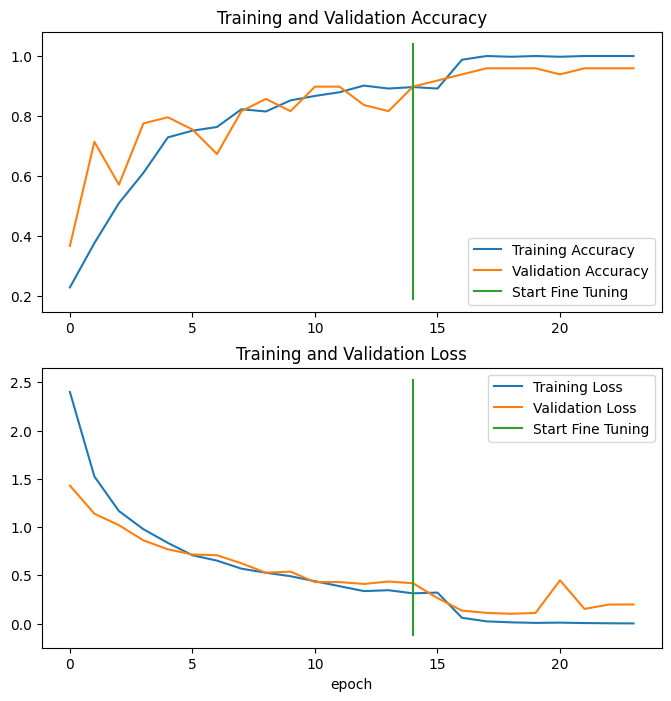

In [95]:
compare_historys(original_history=history_resnet,
                 new_history=history_resnet_fine_tuning,
                 initial_epochs=pretraining_epochs)

# Analyze Experiment Results

In [96]:
simple_cnn_metrics = {'loss':loss_simplecnn, 'accuracy':accuracy_simplecnn}
effnet_metrics = {'loss':loss_effnet, 'accuracy':accuracy_effnet}
effnet_fine_tuning_metrics = {'loss':fine_tune_effnet_loss, 'accuracy':fine_tune_effnet_accuracy}
resnet_metrics = {'loss':loss_resnet50, 'accuracy':accuracy_resnet50}
resnet_fine_tuning_metrics = {'loss':loss_fine_tune_resnet50, 'accuracy':accuracy_fine_tune_resnet50}

In [97]:
data = {
    'Simple CNN': simple_cnn_metrics,
    'EfficientNet (Feature Extraction)': effnet_metrics,
    'EfficientNet (Fine-Tuning)': effnet_fine_tuning_metrics,
    'ResNet50 (Feature Extraction)': resnet_metrics,
    'ResNet50 (Fine-Tuning)': resnet_fine_tuning_metrics}

In [98]:
import pandas as pd
df = pd.DataFrame.from_dict(data, orient='index')

In [99]:
df

,loss,accuracy
Simple CNN,1.731777,0.204082
EfficientNet (Feature Extraction),0.404922,0.897959
EfficientNet (Fine-Tuning),0.332719,0.897959
ResNet50 (Feature Extraction),0.418698,0.897959
ResNet50 (Fine-Tuning),0.198650,0.959184


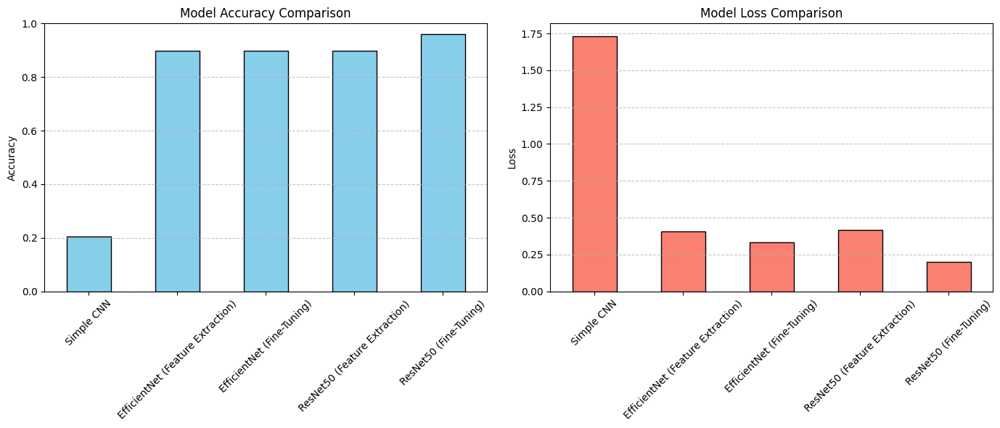

In [100]:
import matplotlib.pyplot as plt

# Create figure and subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Accuracy plot
df['accuracy'].plot(kind='bar', ax=axes[0], color='skyblue', edgecolor='black')
axes[0].set_title('Model Accuracy Comparison')
axes[0].set_ylabel('Accuracy')
axes[0].set_ylim(0, 1)
axes[0].tick_params(axis='x', rotation=45)
axes[0].grid(axis='y', linestyle='--', alpha=0.7)

# Loss plot
df['loss'].plot(kind='bar', ax=axes[1], color='salmon', edgecolor='black')
axes[1].set_title('Model Loss Comparison')
axes[1].set_ylabel('Loss')
axes[1].tick_params(axis='x', rotation=45)
axes[1].grid(axis='y', linestyle='--', alpha=0.7)

# Adjust layout
plt.tight_layout()
plt.show()

# Visualize Experiment Results with TensorBoard

In [101]:
%load_ext tensorboard
%tensorboard --logdir /content/model_logs

<IPython.core.display.Javascript object>